<a href="https://colab.research.google.com/github/JeppeLL/Thesis/blob/master/GAN_generate.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Load network + pickle

In [ ]:
network_pkl = 'network-snapshot-006046'
network_path = f'/content/drive/My Drive/Thesis/stylegan2/network_pickles/{network_pkl}.pkl'

In [ ]:
import os
import time
import glob
import pickle
import PIL.Image
from PIL import Image
import numpy as np

%tensorflow_version 1.x
import tensorflow as tf
print(tf.__version__)
print(tf.test.gpu_device_name())

os.chdir('/content/drive/My Drive/Thesis/stylegan2/')
import dnnlib
import dnnlib.tflib as tflib
import pretrained_networks
print('Loading networks from "%s"...' % network_pkl)
_G, _D, Gs = pretrained_networks.load_networks(network_path)

TensorFlow 1.x selected.
1.15.2
/device:GPU:0
Loading networks from "network-snapshot-006046"...
Setting up TensorFlow plugin "fused_bias_act.cu": Preprocessing... Loading... Done.
Setting up TensorFlow plugin "upfirdn_2d.cu": Preprocessing... Loading... Done.


# Define parameters
- number of images to generate
- should we also save ws?
- save path

In [ ]:
N = 500 #number of images to generate
save_ws = False
save_images = False
save_path = f'/content/drive/My Drive/Thesis/generated_images/{network_pkl}/'
truncation_psi=[1.0]

# Define functions

In [ ]:
def generate_zs_from_seeds(seeds,Gs=Gs):
    zs = []
    for seed_idx, seed in enumerate(seeds):
        rnd = np.random.RandomState(seed)
        z = rnd.randn(1, *Gs.input_shape[1:]) # [minibatch, component]
        zs.append(z)
    return zs

def convertZtoW(latent, Gs=Gs, truncation_psi=1.0, truncation_cutoff=9):
    dlatent = Gs.components.mapping.run(latent, None) # [seed, layer, component]
    dlatent_avg = Gs.get_var('dlatent_avg') # [component]
    for i in range(truncation_cutoff):
        dlatent[0][i] = (dlatent[0][i]-dlatent_avg)*truncation_psi + dlatent_avg
    return dlatent

def generate_ws_from_seeds(seeds,Gs=Gs,truncation_psi=1.0):
    zs = generate_zs_from_seeds(seeds,Gs)
    ws=list()
    for i,z in enumerate(zs):
        w=convertZtoW(z, Gs, truncation_psi=truncation_psi)
        #w=w[0,0,:]
        #print(w)
        if i % 500 == 0:
            print(f"Progress: {i} of {len(zs)}")
            #print(w.shape)
        ws.append(w)
    return ws

def generate_images_in_w_space(dlatents, Gs=Gs,save=False):
    Gs_kwargs = dnnlib.EasyDict()
    Gs_kwargs.output_transform = dict(func=tflib.convert_images_to_uint8, nchw_to_nhwc=True)
    Gs_kwargs.randomize_noise = False
    #Gs_kwargs.truncation_psi = truncation_psi
    #dlatent_avg = Gs.get_var('dlatent_avg') # [component]

    imgs = []
    for i in range(len(dlatents)):
        if i%500==0:
            #clear_output(wait=True)
            print(f"Progress: {i} out of {len(dlatents)}")
        correct_shape = np.tile(dlatents[i],[1,14,1])
        #correct_shape = np.squeeze([np.float32(w_i)],axis=0)
            
        row_images = Gs.components.synthesis.run(correct_shape,  **Gs_kwargs)
        imgs.append(Image.fromarray(row_images[0], 'RGB'))
        #imgs.append(imgs_w_i)
    return imgs

def list_of_PIL_to_np(images):
  length=len(images)
  out = np.zeros((length,256,256,3))
  for i in range(length):
    img_np = np.asarray(images[i])
    out[i] = img_np
  return out.astype(np.uint8)

# Run

In [ ]:
ys_list   =[]

for psi in truncation_psi:
  seeds = list(range(N))
  #print(f"Generating {N} zs")
  #zs = generate_zs_from_seeds(seeds)
  print(f"Generating {N} ws")
  ws = generate_ws_from_seeds(seeds,truncation_psi=psi)
  #ws = convertZtoW(zs)
  print(f"Generating {N} ys")
  ys = generate_images_in_w_space(ws)
  print("Converting PIL images to numpy")
  ys = list_of_PIL_to_np(ys)
  #add to list for each truncation_psi
  ys_list.append(ys)

  if save_images:
    print(f"Saving images")
    try:
      os.mkdir(save_path+f'truncation_{psi}/')
      print(f"Creating path: {save_path}truncation_{psi}/")
    except:
      pass
    pickle.dump(ys,open(save_path+f'truncation_{psi}/generated_images.pkl','wb'))
  if save_ws:
    print(f"Saving ws")
    try:
      os.mkdir(save_path+f'truncation_{psi}/')
      print(f"Creating path: {save_path}truncation_{psi}/")
    except:
      pass
    pickle.dump(ws,open(save_path+f'truncation_{psi}/generated_ws.pkl','wb'))

Generating 500 ws
Progress: 0 of 500
Generating 500 ys
Progress: 0 out of 500
Converting PIL images to numpy


## Look at psi's effect

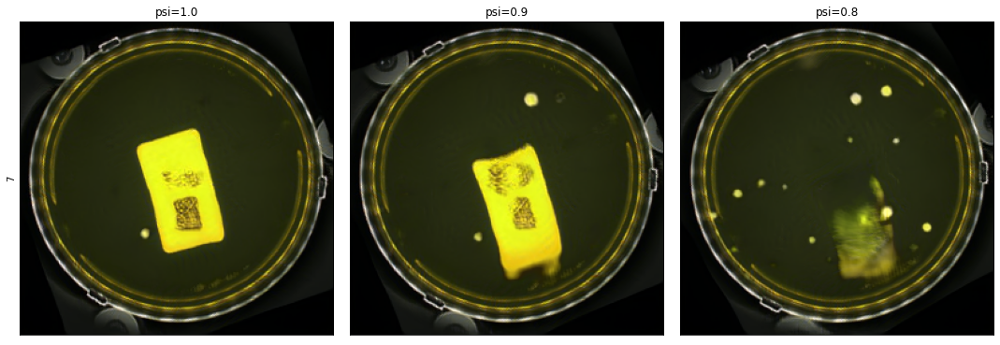

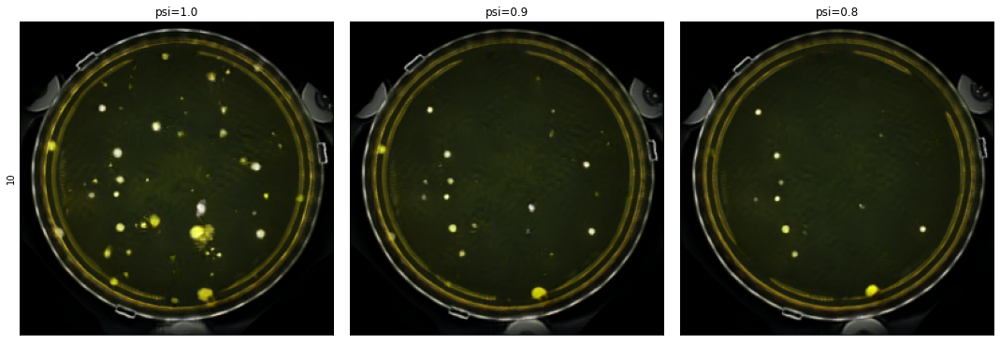

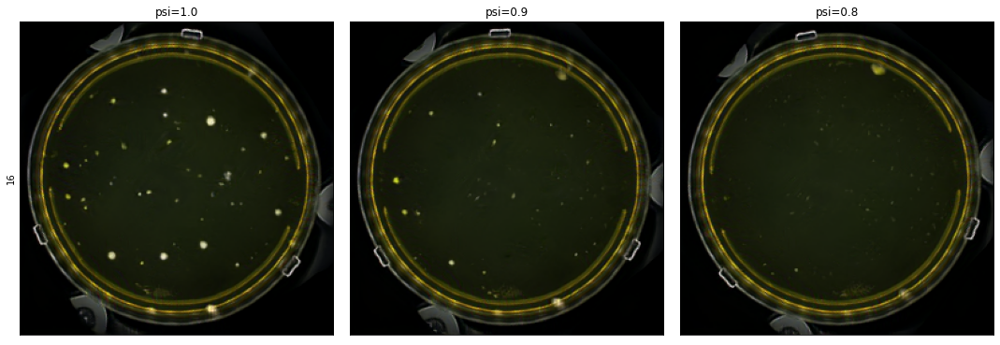

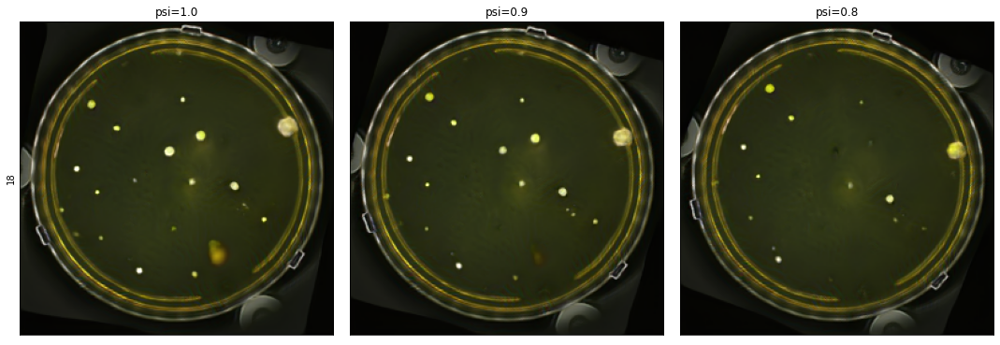

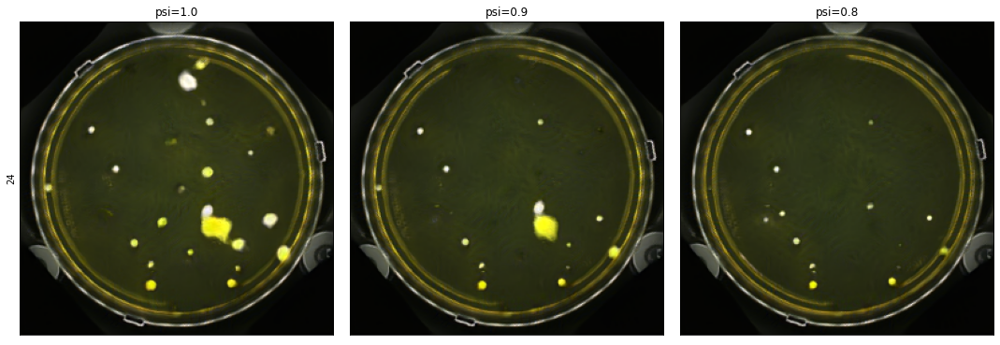

...

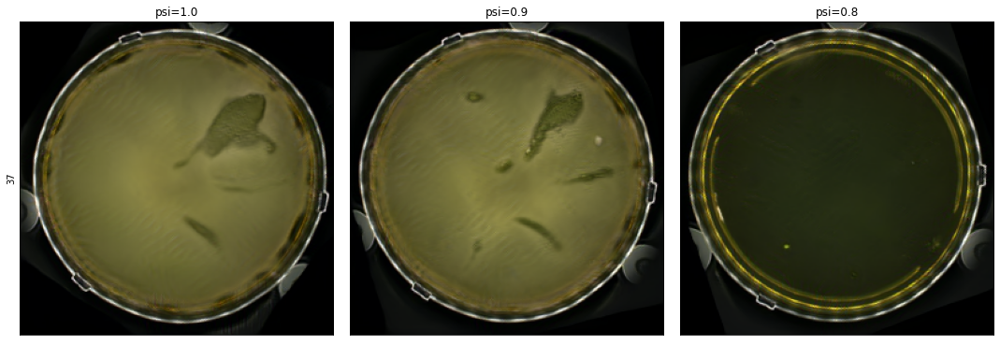

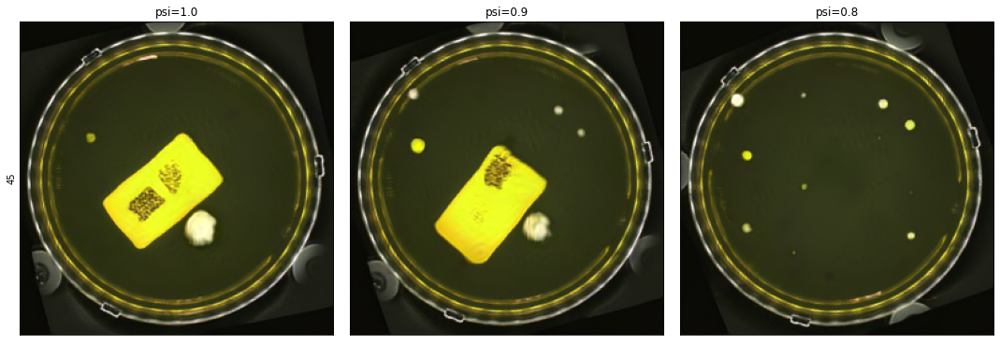

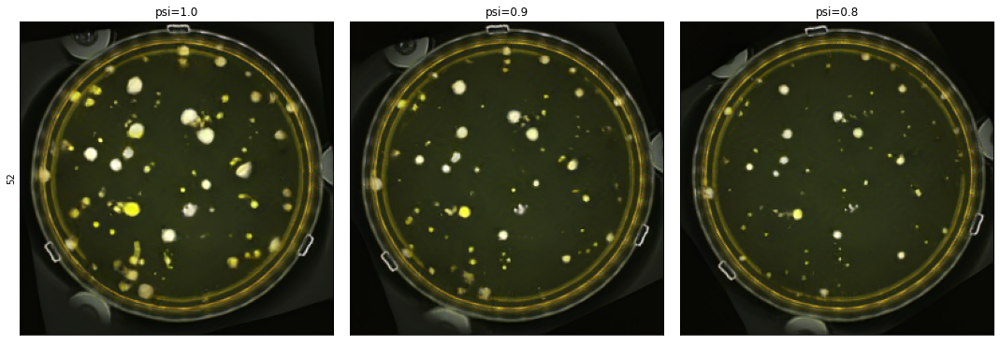

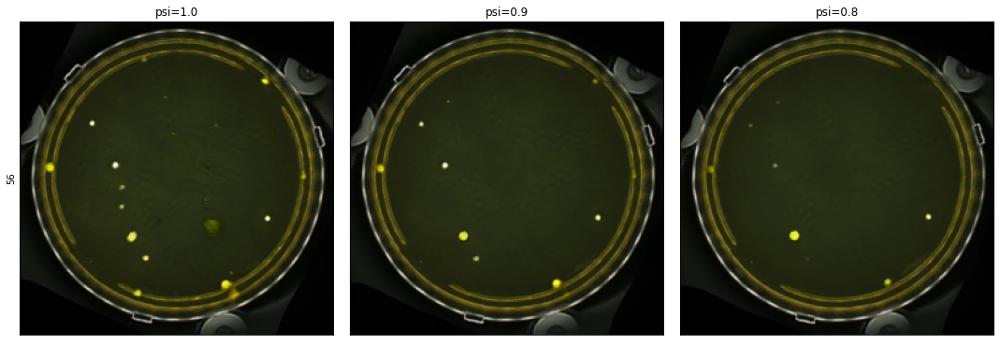

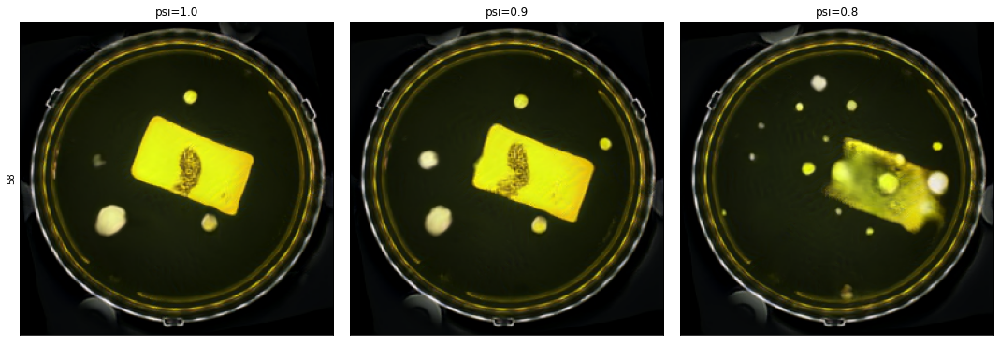

In [ ]:
import matplotlib.pyplot as plt
psi_10=ys_list[0]
psi_09=ys_list[1]
psi_08=ys_list[2]

for i in [7, 10, 16, 18, 24, 26, 36, 37, 45, 52, 56, 58]:
  fig,axes = plt.subplots(ncols=3,figsize=(15,5),sharey=True)
  axes[0].imshow(psi_10[i])
  axes[0].set_xticks([])
  axes[0].set_yticks([])
  axes[0].set_ylabel(str(i))
  axes[0].title.set_text('psi=1.0')
  axes[1].imshow(psi_09[i])
  axes[1].set_xticks([])
  axes[1].set_yticks([])
  axes[1].title.set_text('psi=0.9')
  axes[2].imshow(psi_08[i])
  axes[2].set_xticks([])
  axes[2].set_yticks([])
  axes[2].title.set_text('psi=0.8')
  fig.tight_layout()
  fig.show()  



## Look at images

In [ ]:
import matplotlib.pyplot as plt

def print_images_loop(images,iteration,seeds,rows=30,cols=4,figsize=5):
  cols=cols
  rows=rows
  seed_offset=iteration*cols*rows #If you have already generated x images, and want new seeds, then set seed_offset=x
  print(f"Printing images ({seed_offset};{seed_offset+rows*cols}) out of total {len(seeds)} images.")

  fig,axes=plt.subplots(nrows=rows,ncols=cols,squeeze=False,
                        figsize=(figsize*cols,figsize*rows))
  for row in range(rows):
    for col in range(cols):
      if row*cols+col+seed_offset < len(seeds):
        seed = seeds[row*cols+col+seed_offset]
        axes[row,col].imshow(images[seed])
        axes[row,col].title.set_text(seed)
  plt.tight_layout()
  plt.show()

Printing images (0;120) out of total 500 images.


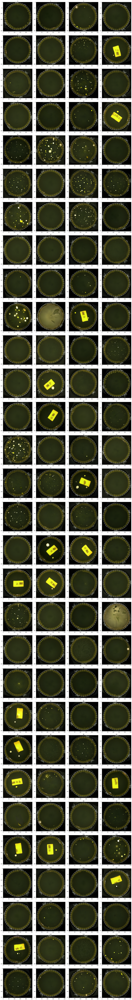

In [ ]:
print_images_loop(np.array(ys_list[0]),0,list(range(500)))